#Open CV

Getting Started

#### Load and see Image

In [1]:
#import Open CV
import cv2

In [2]:
#check version
print(cv2.__version__)

4.6.0


In [3]:
#Download and unzip images
!wget https://moderncomputervision.s3.eu-west-2.amazonaws.com/images.zip
!unzip -qq images.zip

--2022-08-26 10:18:13--  https://moderncomputervision.s3.eu-west-2.amazonaws.com/images.zip
Resolving moderncomputervision.s3.eu-west-2.amazonaws.com (moderncomputervision.s3.eu-west-2.amazonaws.com)... 52.95.149.50
Connecting to moderncomputervision.s3.eu-west-2.amazonaws.com (moderncomputervision.s3.eu-west-2.amazonaws.com)|52.95.149.50|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 29586716 (28M) [application/zip]
Saving to: ‘images.zip’

images.zip          100%[===================>]  28.22M  18.4MB/s    in 1.5s    

2022-08-26 10:18:15 (18.4 MB/s) - ‘images.zip’ saved [29586716/29586716]



In [4]:
#load image using imread
image = cv2.imread('/content/images/flowers.jpeg')

#to see the image array
image

array([[[28, 62, 32],
        [28, 62, 32],
        [28, 62, 32],
        ...,
        [13, 36, 28],
        [11, 34, 26],
        [ 8, 31, 23]],

       [[28, 62, 32],
        [28, 62, 32],
        [28, 62, 32],
        ...,
        [11, 34, 26],
        [ 9, 32, 24],
        [ 7, 30, 22]],

       [[28, 62, 32],
        [28, 62, 32],
        [28, 62, 32],
        ...,
        [ 9, 32, 24],
        [ 9, 32, 24],
        [ 7, 30, 22]],

       ...,

       [[40, 39, 43],
        [40, 39, 43],
        [39, 38, 42],
        ...,
        [14, 14, 20],
        [14, 14, 20],
        [14, 14, 20]],

       [[40, 39, 43],
        [40, 39, 43],
        [39, 38, 42],
        ...,
        [14, 14, 20],
        [14, 14, 20],
        [14, 14, 20]],

       [[40, 39, 43],
        [40, 39, 43],
        [39, 38, 42],
        ...,
        [14, 14, 20],
        [14, 14, 20],
        [14, 14, 20]]], dtype=uint8)

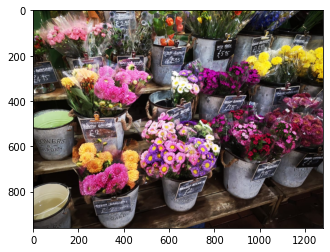

In [5]:
#displaying images
from matplotlib import pyplot as plt

#show images with matplotlib
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.show()

###### Use function to make display easier

In [6]:
def imshow(title="", image = None):
  plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
  plt.title(title)
  plt.show()

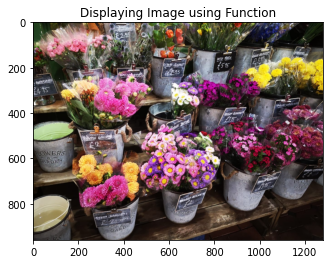

In [7]:
#displaying image using functions
imshow("Displaying Image using Function", image)

#### Saving Images

In [8]:
#saving image
cv2.imwrite('output.jpg', image)

#to save as png
cv2.imwrite('output.png', image)

True

openCV saves images as numpy objects

In [9]:
#numpy
import numpy
print(image.shape)

(960, 1280, 3)


In [10]:
#to acess image dimension
height = image.shape[0]
width = image.shape[1]
depth = image.shape[2]

print("height is",height, "Width is", width, "Depth is", depth)

height is 960 Width is 1280 Depth is 3


#### Grayscale

In [11]:
#Improved Imshow function
def imshow(title="", image = None, size=10):
  w, h = image.shape[0], image.shape[1]
  aspect_ratio = w/h
  plt.figure(figsize=(size * aspect_ratio, size))
  plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
  plt.title(title)
  plt.show()

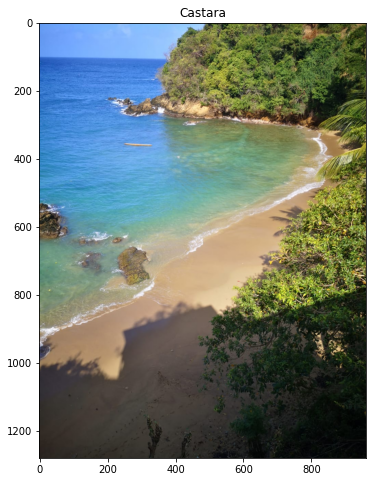

In [12]:
#Load image
image = cv2.imread('./images/castara.jpeg')
imshow("Castara", image, size = 8)

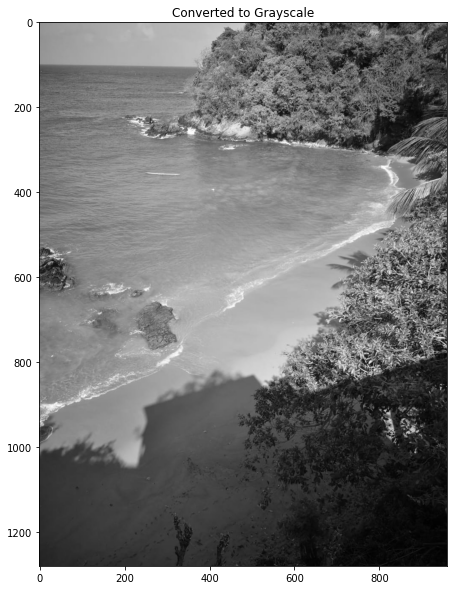

In [13]:
#we use cvtColor to convert to grayscale
#2 arguments : Input image, Color space conversion code

#convert to grayscale
gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

#display
imshow("Converted to Grayscale", gray_image)

In [14]:
#only one on this cell will work

#normal image dimension
image.shape

#gray image 
gray_image.shape

(1280, 960)

#### RGB and HSV

In [15]:
#load image
image = cv2.imread('./images/castara.jpeg')

#Use cv2 to split color space separately
B,G,R = cv2.split(image)
print(B.shape)
print(G.shape)
print(R.shape)

(1280, 960)
(1280, 960)
(1280, 960)


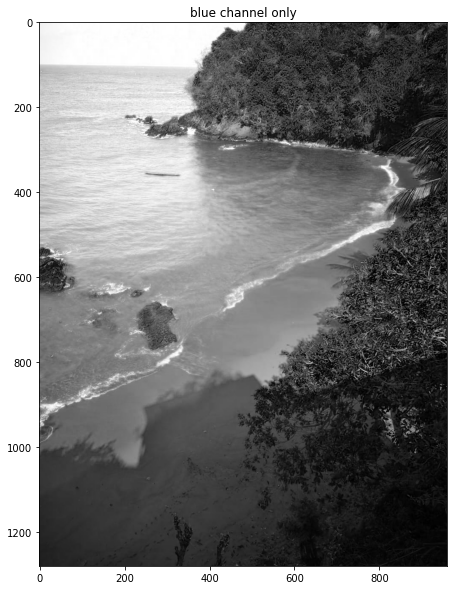

In [16]:
imshow("blue channel only", B)

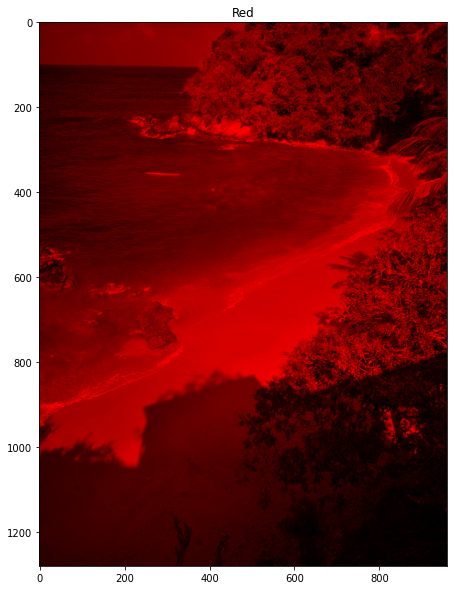

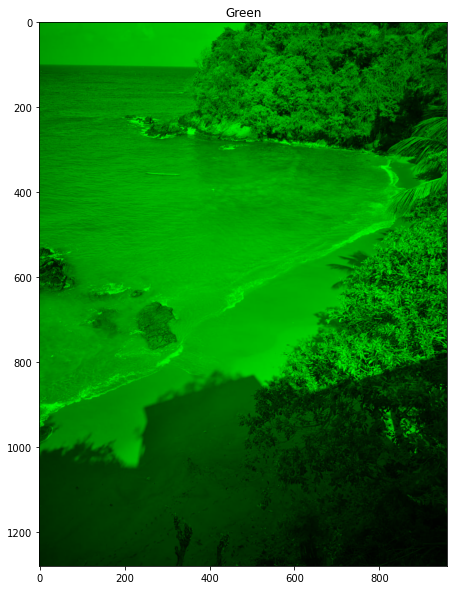

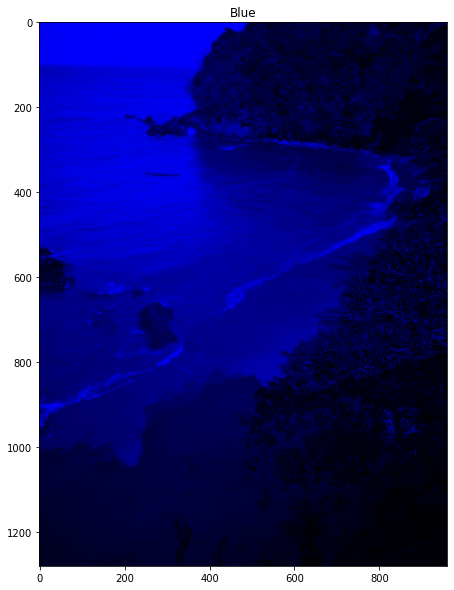

In [17]:
import numpy as np

#blank matrix with dimension of image
zeros = np.zeros(image.shape[:2], dtype = "uint8")

imshow("Red", cv2.merge([zeros, zeros, R]))
imshow("Green", cv2.merge([zeros, G, zeros]))
imshow("Blue", cv2.merge([B, zeros, zeros]))

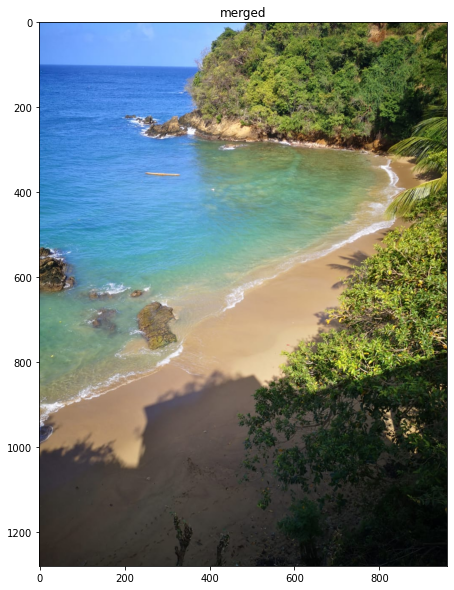

In [18]:
#reading image whole

#open cv split function
B, G, R = cv2.split(image)

#remaking the original image
merged = cv2.merge([B,G,R])
imshow("merged", merged)

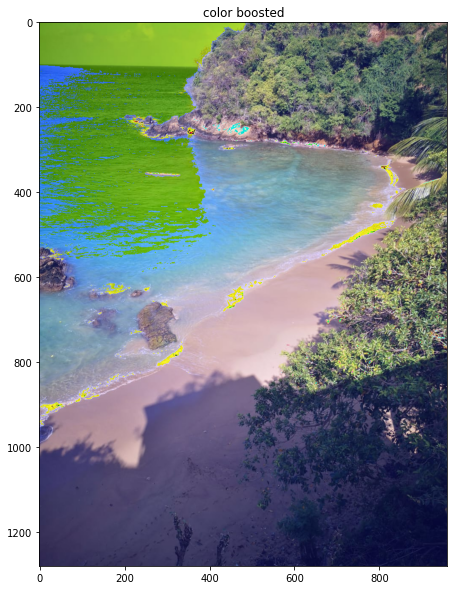

In [19]:
#color boosted blue
merged = cv2.merge([B+50, G+5, R+5])
imshow("color boosted", merged)

*hsv*

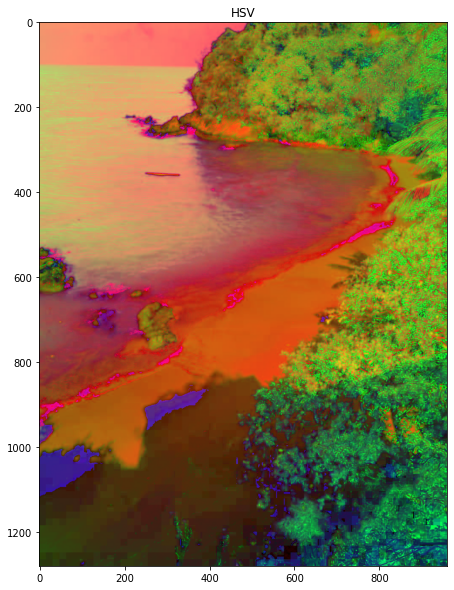

In [20]:
#load image
image = cv2.imread('./images/castara.jpeg')

#convert to HSV
hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
imshow('HSV', hsv_image)

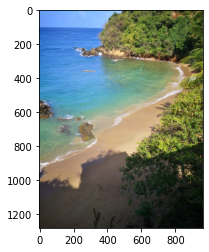

In [21]:
plt.imshow(cv2.cvtColor(hsv_image, cv2.COLOR_HSV2RGB))
plt.show()

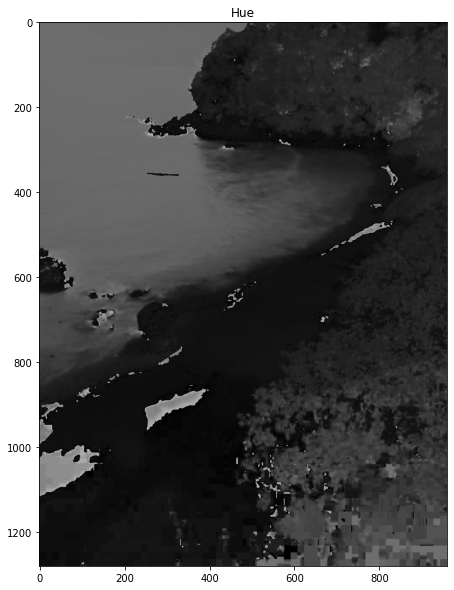

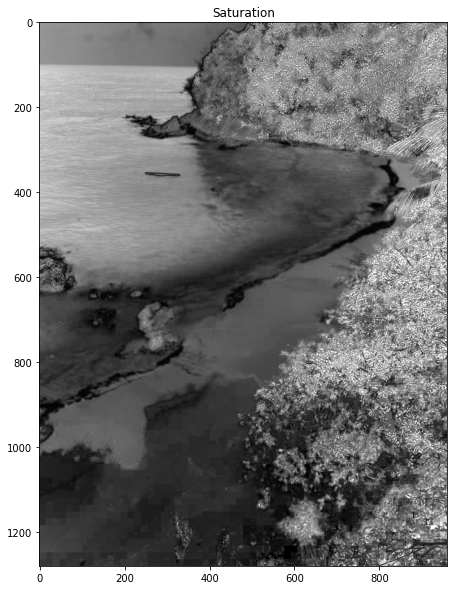

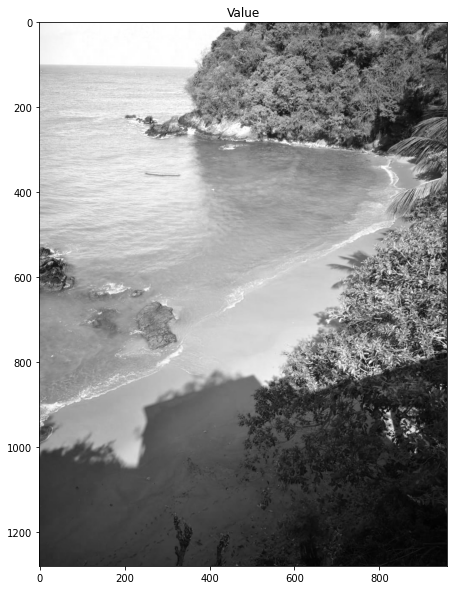

In [22]:
imshow("Hue", hsv_image[:,:,0])
imshow("Saturation", hsv_image[:,:,1])
imshow("Value", hsv_image[:,:,2])

#### Drawing images and shapes using OpenCV

##### blank square canvas

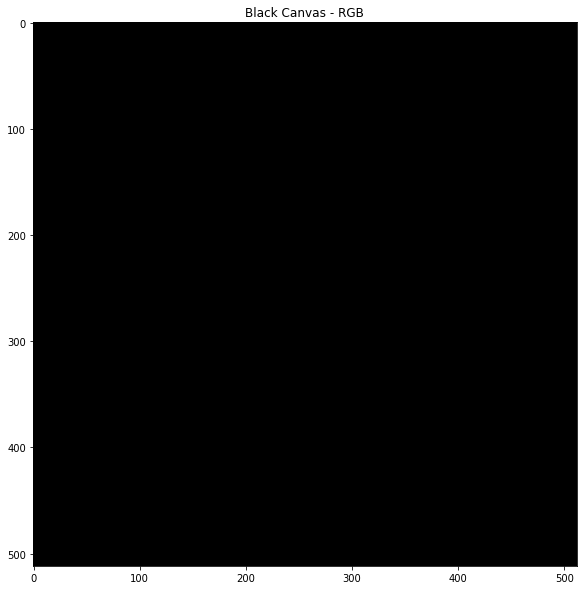

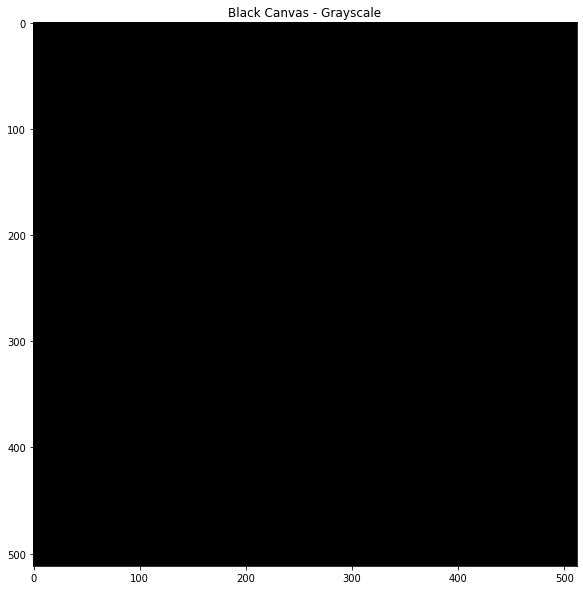

In [23]:
#create black image
image = np.zeros((512, 512, 3), np.uint8)

#grayscale black
image_gray = np.zeros((512,512), np.uint8)

#black would be same as grayscale or color image
imshow("Black Canvas - RGB", image)
imshow("Black Canvas - Grayscale", image_gray)

##### Drawing a line

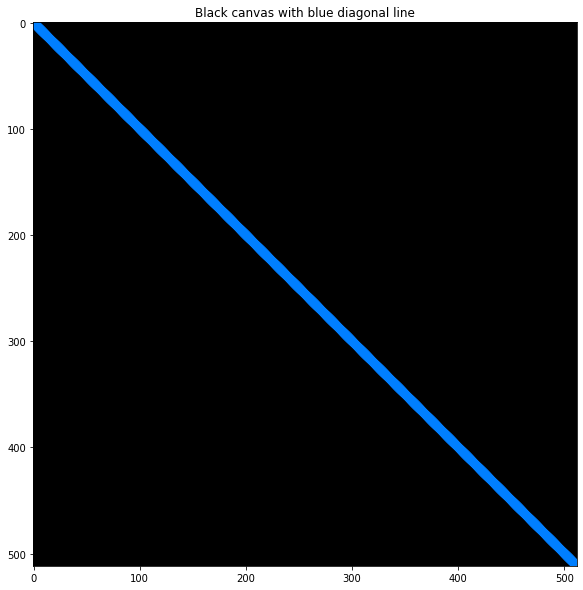

In [24]:
#line(image, starting cordinates, ending cordinates, color, thickness)

cv2.line(image,(0,0),(511,511),(255,127,0),8)
imshow("Black canvas with blue diagonal line", image)

##### Rectangle

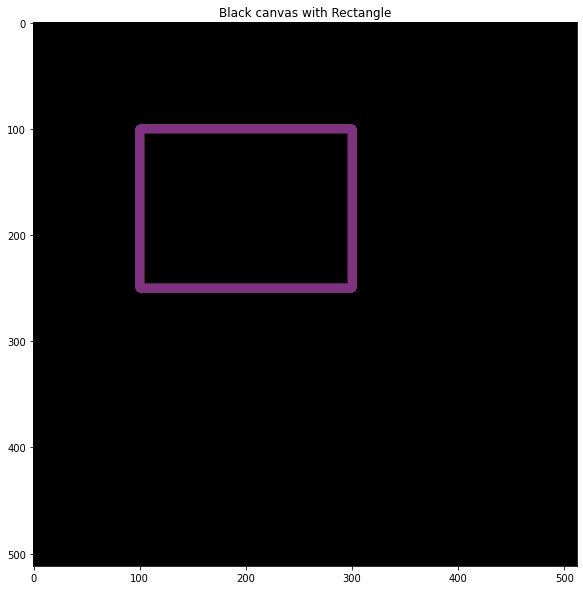

In [25]:
#rectangle(image, starting vertex, opposite vertex, color , thickness)

#create new black canvas
image = np.zeros((512,512,3), np.uint8)

#if positive = thickness, if negative - it is filled
cv2.rectangle(image, (100,100), (300,250), (127,50,127), 8)
imshow("Black canvas with Rectangle", image)

##### Circle

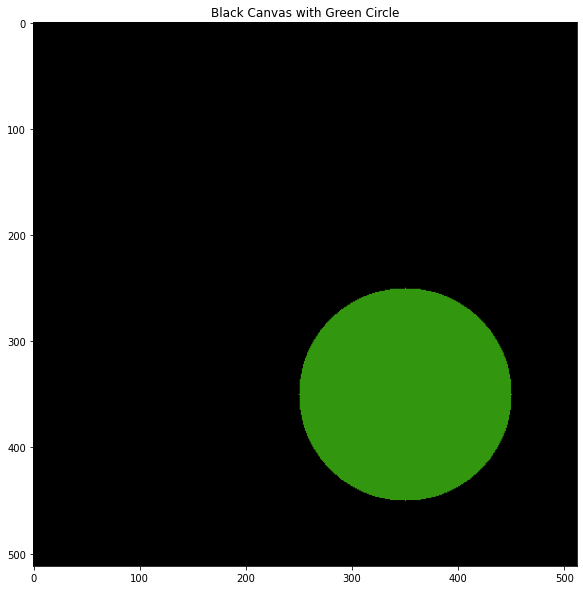

In [26]:
#circle(image, center, radius, color, fill)
#using inplace function
#create canvas
image = np.zeros((512,512,3), np.uint8)

cv2.circle(image, (350,350),100,(15,150,50),-1)
imshow("Black Canvas with Green Circle", image)

##### polygon

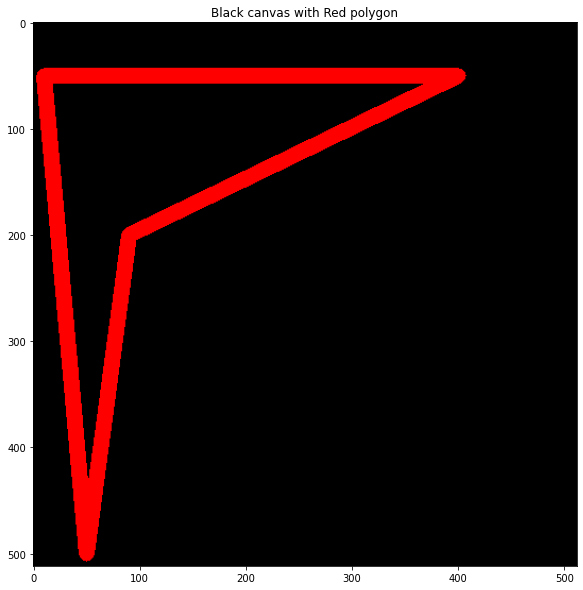

In [27]:
#polylines (image, points, closed, color, thickness)
image = np.zeros((512,512,3), np.uint8)

#define 4 points
pts = np.array([[10,50], [400,50], [90,200], [50,500]], np.int32)

#reshape in the form required by polylines
pts = pts.reshape((-1,1,2))

cv2.polylines(image, [pts], True, (0,0,255), 13)
imshow("Black canvas with Red polygon", image)

##### Text

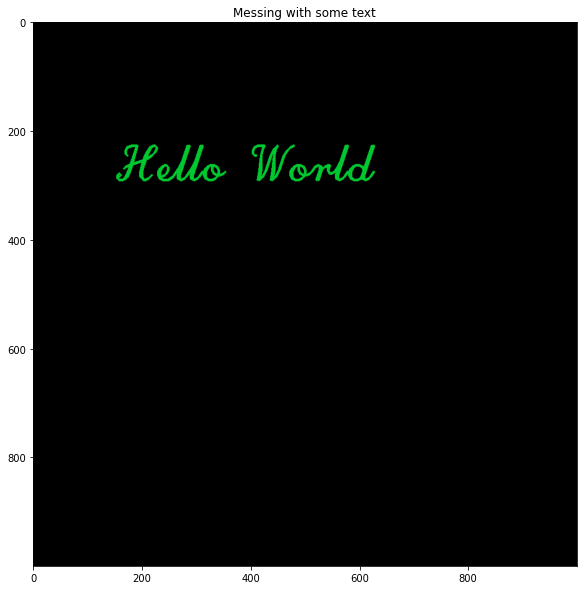

In [28]:
#puttext = (image, 'Text to Display', bottom left starting point, Font, Font Size, Color, Thickness)

image = np.zeros((1000,1000,3), np.uint8)
ourString = 'Hello World'
cv2.putText(image, ourString, (155, 290), cv2.FONT_HERSHEY_SCRIPT_COMPLEX, 3, (48, 200, 0),4)
imshow("Messing with some text", image)

# Transformations

* Image translations
* Rotations with getRotationMatrix2D
* Rotations with Transpose
* Flipping Images

Translation

* Affine transform that Shifts the position of Image

cv2.warpAffine(image, T, (width, height)

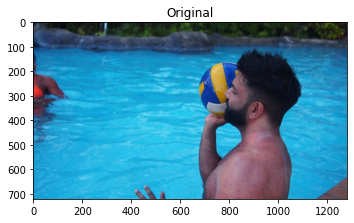

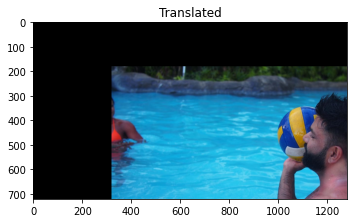

In [29]:
#load image
image = cv2.imread('/content/images/Volleyball.jpeg')
imshow("Original", image)

#store the height and width
height, width = image.shape[:2]

#shift it by quarter of height and width
quarter_height, quarter_width = height/4, width/4

#T = Translation Matrix
T = np.float32([[1,0,quarter_width], [0,1,quarter_height]])

#using warpaffine to transform the image
img_translation = cv2.warpAffine(image, T, (width,height))
imshow("Translated", img_translation)

In [30]:
#This is what transformation looks like
print(T)
print(height, width)

[[  1.   0. 320.]
 [  0.   1. 180.]]
720 1280


##### Rotation

cv2.getRotationMatrix2d(rotation_center_x, rotation_center_y, angle of rotation, scale)

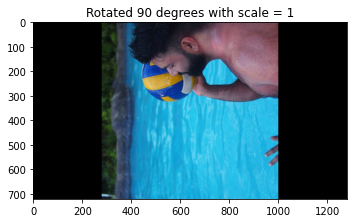

In [31]:
#load image
image = cv2.imread('/content/images/Volleyball.jpeg')
height, width = image.shape[:2]

#Divide by two to rotate image around its centre
rotation_matrix = cv2.getRotationMatrix2D((width/2, height/2), 90, 1)

#Add image to see results
rotated_image = cv2.warpAffine(image, rotation_matrix, (width, height))
imshow("Rotated 90 degrees with scale = 1", rotated_image)

[[ 3.061617e-17  5.000000e-01  4.600000e+02]
 [-5.000000e-01  3.061617e-17  6.800000e+02]]


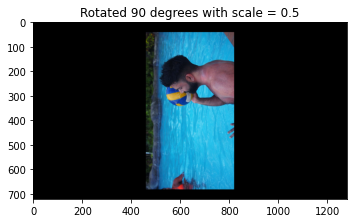

In [32]:
#divide by two to rotate the image around its centre
rotation_matrix = cv2.getRotationMatrix2D((width/2, height/2),90, 0.5)
print(rotation_matrix)
#Load image
rotated_image = cv2.warpAffine(image, rotation_matrix, (width, height))
imshow("Rotated 90 degrees with scale = 0.5", rotated_image)

To crop all black part 

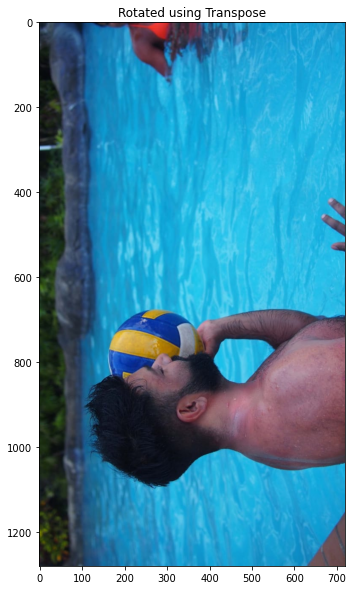

In [33]:
rotated_image = cv2.transpose(image)
imshow("Rotated using Transpose", rotated_image)

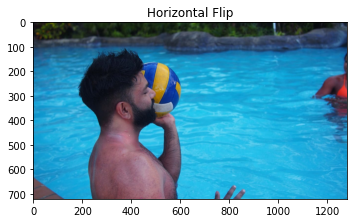

In [34]:
#flip
flipped = cv2.flip(image, 1)
imshow("Horizontal Flip", flipped)

# Scaling, Resizing, Interpolation and Cropping

cv2.resize(image, dsize(output image size), xscale, yscale, interpolation)

* *INTER_NEAREST* - a nearest neighbor interpolation
* *INTER_LINEAR* - a billinear interpolation (used by default)
* *INTER_AREA* - resampling using pixel area relation. It may be a preffered method for Image Descrimination, as it gives molre-free results but when image is zoomed it is similar to INTER_NEAREST
* *INTER_CUBIC* - a bicubic interpolation over 4x4 pixel neighborhood
* *INTER_LANCZOS4* - a Lanczos interpolation over 8x8 pixel


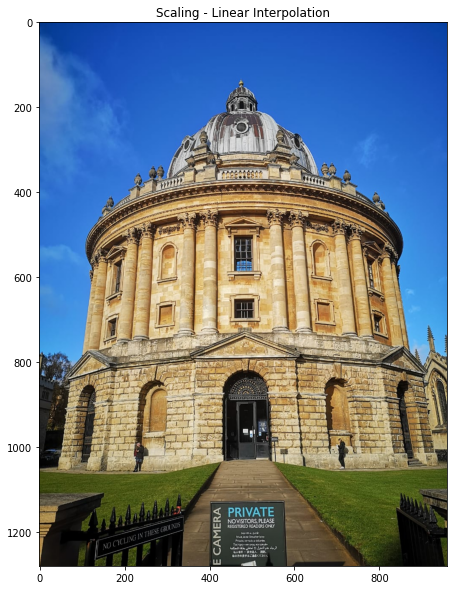

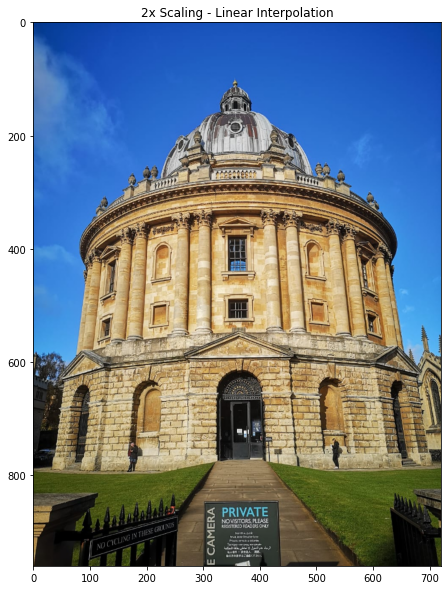

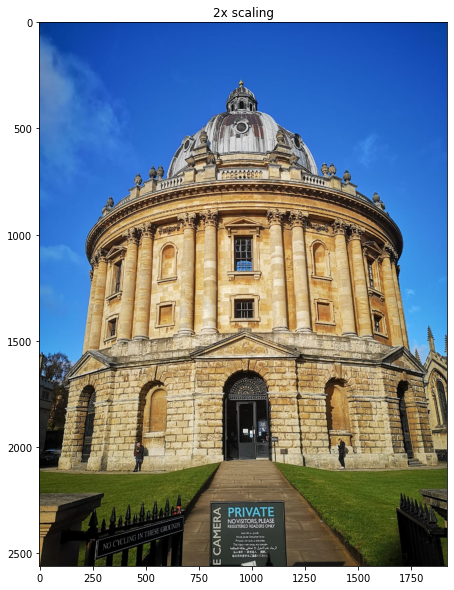

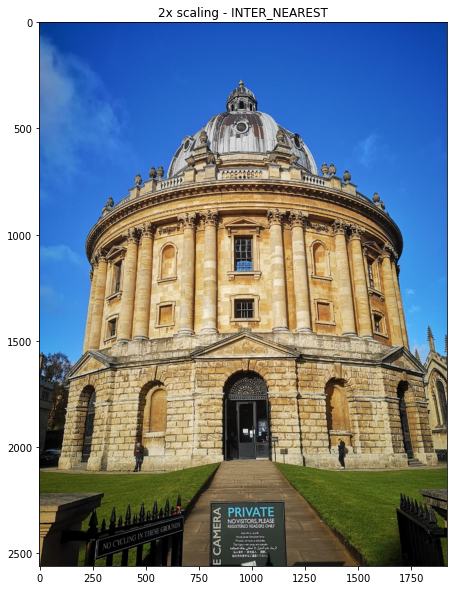

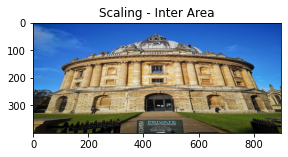

In [35]:
#load image
image = cv2.imread('/content/images/oxfordlibrary.jpeg')
imshow("Scaling - Linear Interpolation", image)

#If no interpolation is specified then cv.INTER_LINEAR is used as default
#Making the image 3/4 of it's original size
image_scaled = cv2.resize(image, None, fx=0.75, fy=0.75)
imshow("2x Scaling - Linear Interpolation", image_scaled)

#doubling the size of image
img_scaled2 = cv2.resize(image, None, fx=2, fy=2, interpolation = cv2.INTER_CUBIC)
imshow("2x scaling", img_scaled2)

#using nearest interpoaltion
img_scaled3 = cv2.resize(image,None, fx=2, fy=2, interpolation=cv2.INTER_NEAREST)
imshow("2x scaling - INTER_NEAREST", img_scaled3)

#setting exact dimension
img_scaled4 = cv2.resize(image, (900, 400), interpolation = cv2.INTER_AREA)
imshow("Scaling - Inter Area", img_scaled4)


#### Image Pyramid

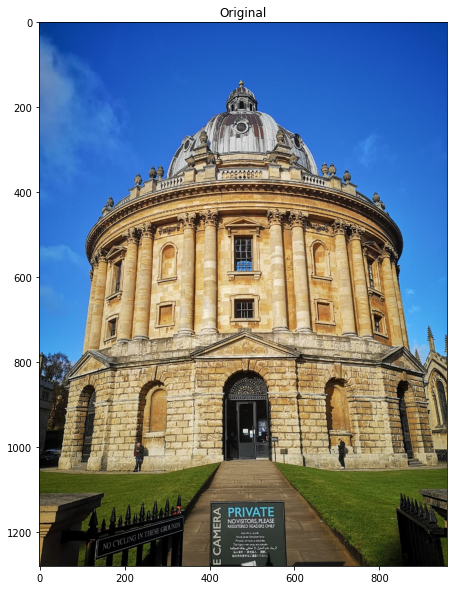

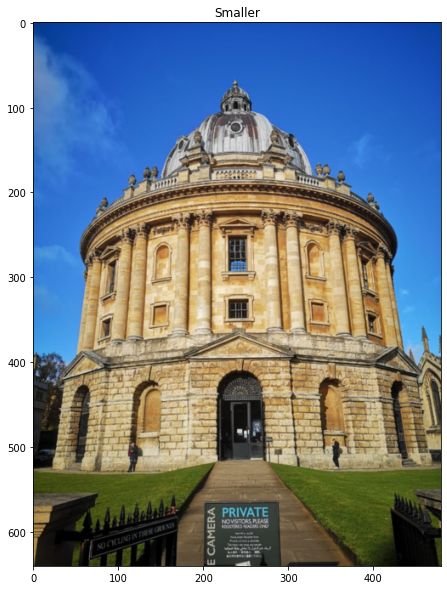

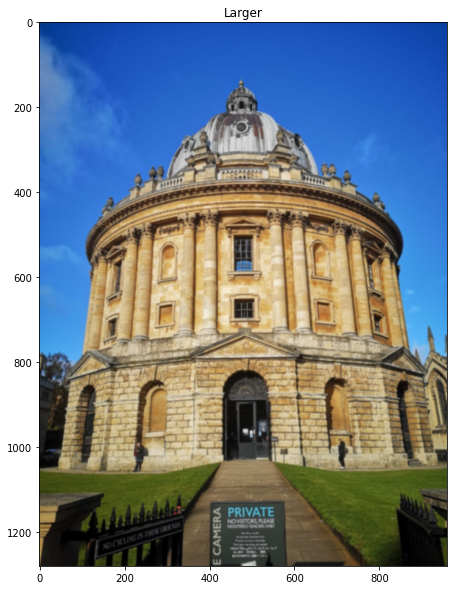

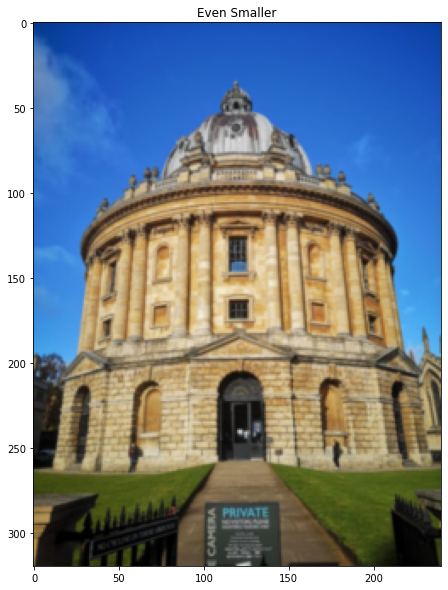

In [36]:
image = cv2.imread('/content/images/oxfordlibrary.jpeg')

smaller = cv2.pyrDown(image)
larger = cv2.pyrUp(smaller)

imshow("Original", image)
imshow("Smaller", smaller)
imshow("Larger", larger)

even_smaller = cv2.pyrDown(smaller)
imshow("Even Smaller", even_smaller)

#### Cropping

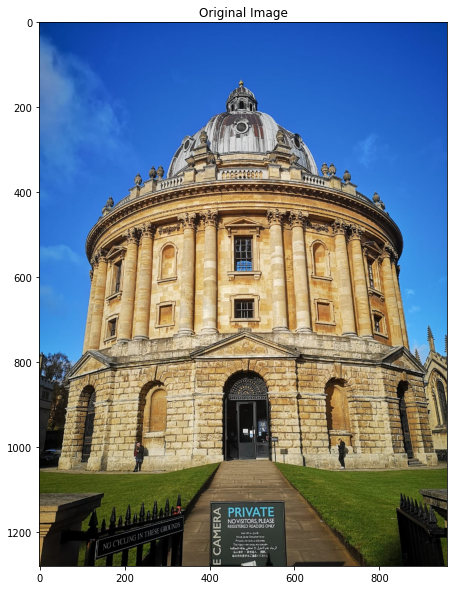

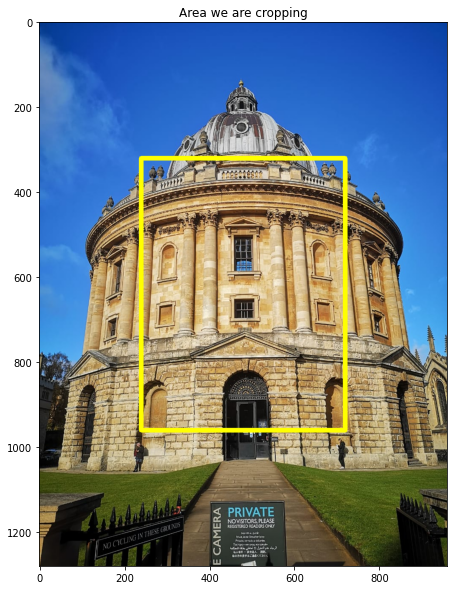

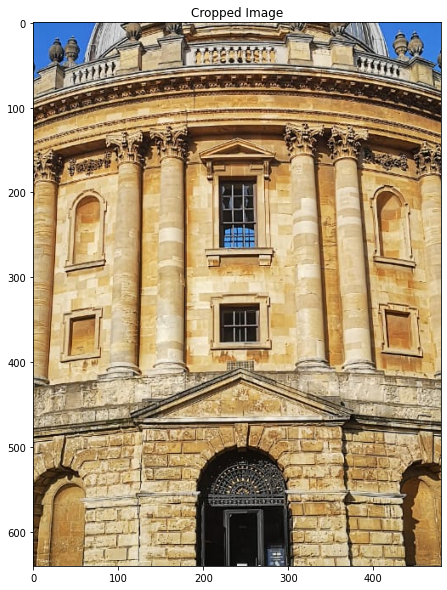

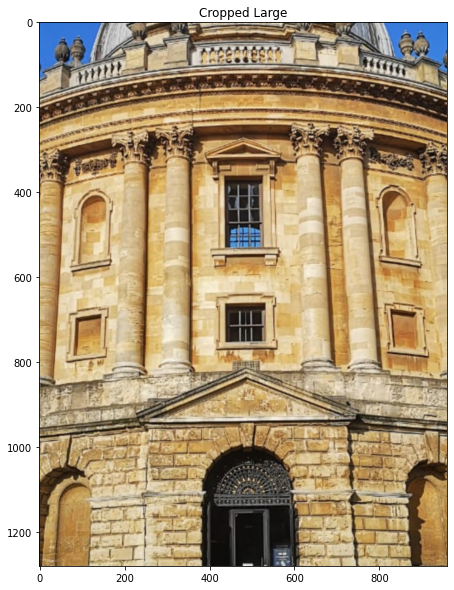

In [37]:
image = cv2.imread('/content/images/oxfordlibrary.jpeg')

#Get image dimension
height, width = image.shape[:2]

#getting starting pixe; cordinates (top left of cropping rectangle)
#using 0.25 to get the x,y position that is 1/4 down from the top left (0,0)
start_row, start_col = int(height * .25), int(width * .25)

#Pixel cordinate from bottom right
end_row, end_col = int(height * .75), int(width * .75)

#using indexing to crop out the rectngle we want
cropped = image[start_row:end_row, start_col:end_col]

imshow('Original Image', image)

#the cv2 Rectangle function draws a rectangle over our image (inplace operation)
copy = image.copy()
cv2.rectangle(copy, (start_col, start_row), (end_col, end_row), (0,255,255), 10)

imshow("Area we are cropping", copy)

imshow("Cropped Image", cropped)

#enlarged
cropped_large = cv2.pyrUp(cropped)
imshow("Cropped Large", cropped_large)

# Arithmetic Operation

* Simple Operations to directly add or subtract the color intensity 
* Calculates pre element operation of two arrays, The overall effect is increasing or decreasing brightness

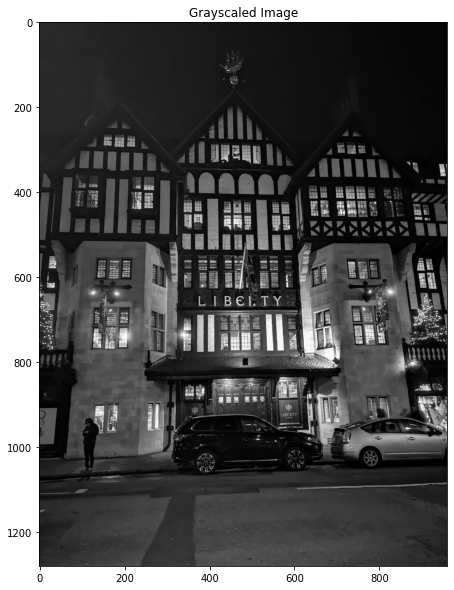

[[41 41 41 ...  5  5  5]
 [41 41 41 ...  5  5  5]
 [41 41 41 ...  5  5  5]
 ...
 [41 42 44 ... 34 33 32]
 [43 44 46 ... 31 30 28]
 [44 45 46 ... 32 30 29]]
[[100 100 100 ... 100 100 100]
 [100 100 100 ... 100 100 100]
 [100 100 100 ... 100 100 100]
 ...
 [100 100 100 ... 100 100 100]
 [100 100 100 ... 100 100 100]
 [100 100 100 ... 100 100 100]]


In [38]:
#Loading in grayscale
# ,0 loads image in gray scale
image = cv2.imread('/content/images/liberty.jpeg', 0)
imshow("Grayscaled Image", image)
print(image)

#create matrix of 1s and multiply it by 100
#gives same dimension of our image with all values being 100
M = np.ones(image.shape, dtype="uint8")*100
print(M)

#### Increasing Brightness

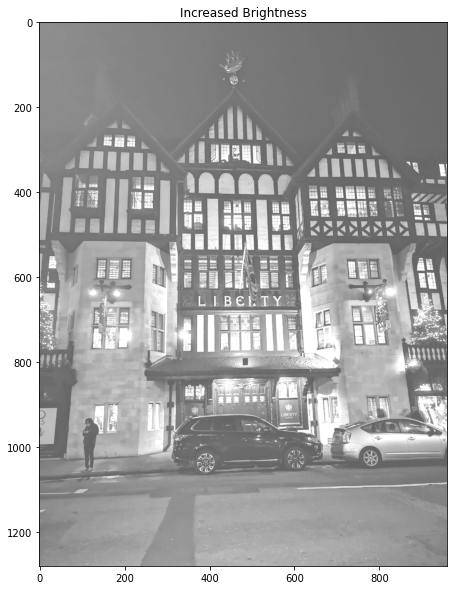

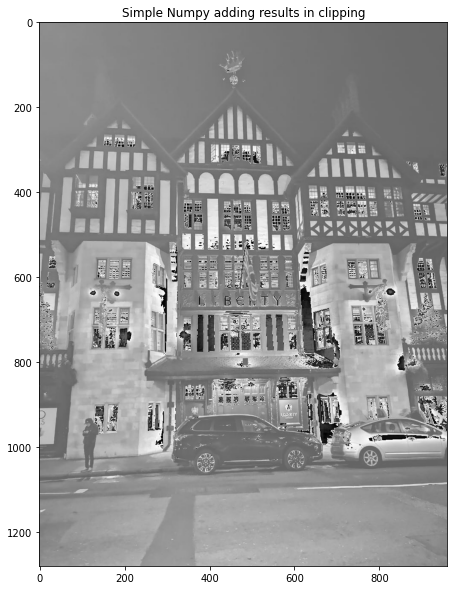

In [39]:
#adding matrix m to our images to increase brightness
added = cv2.add(image, M)
imshow("Increased Brightness", added)

#Adding it directly
added2 = image + M
imshow("Simple Numpy adding results in clipping", added2)

#### Decreasing Brightness

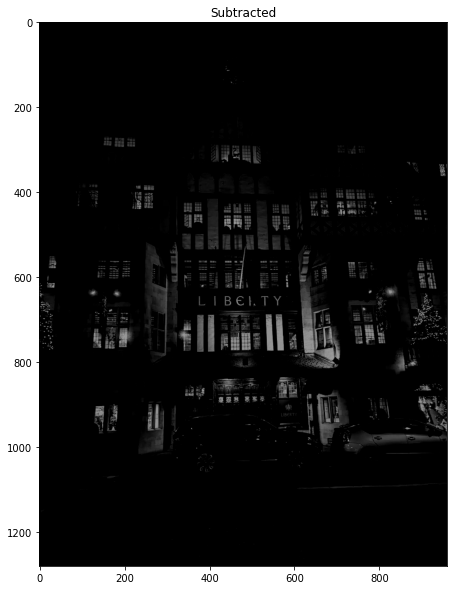

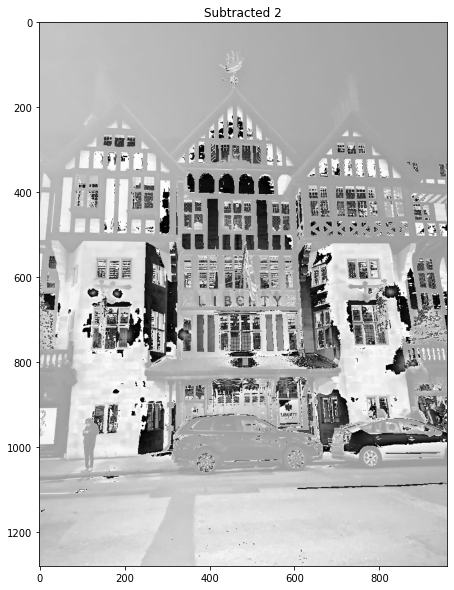

In [40]:
#Decreasing Brightness
subtracted = cv2.subtract(image, M)
imshow("Subtracted", subtracted)

subtracted2 = image - M
imshow("Subtracted 2", subtracted2)

# Bitwise Operation

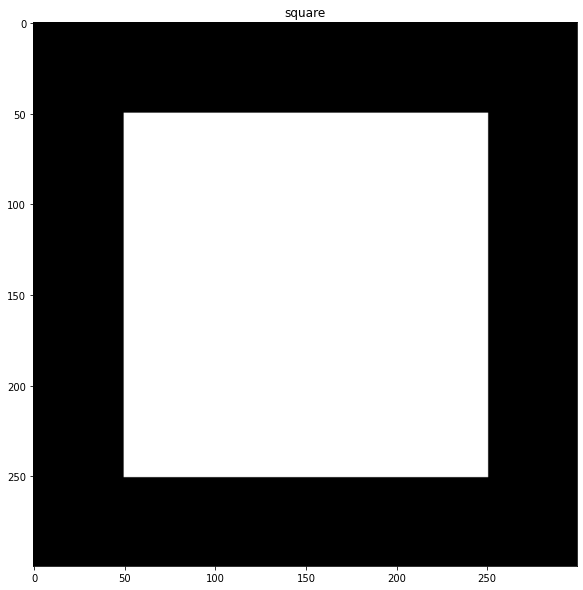

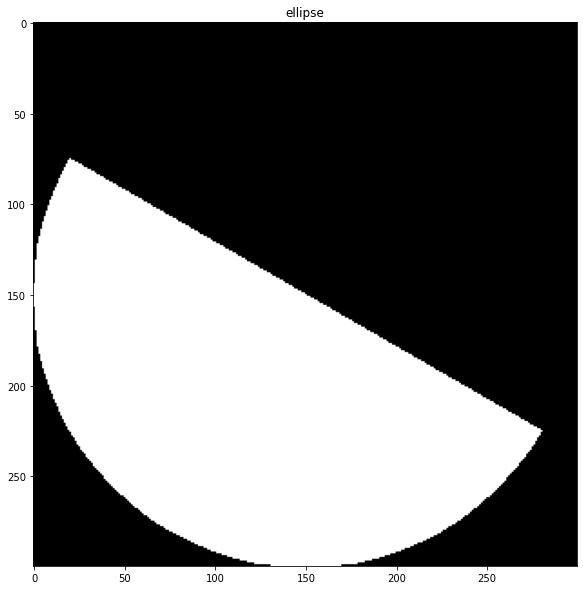

In [41]:
#Make a square
square = np.zeros((300, 300), np.uint8)
cv2.rectangle(square, (50,50), (250,250), 255, -2)
imshow("square", square)

#making a ellipse
ellipse = np.zeros((300, 300), np.uint8)
cv2.ellipse(ellipse, (150,150), (150,150), 30, 0, 180, 255, -1)
imshow("ellipse", ellipse)

##### Bitwise AND, OR, XOR, NOT


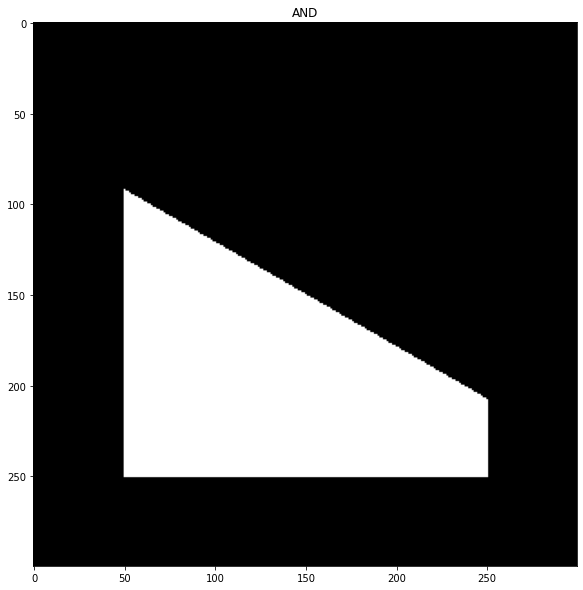

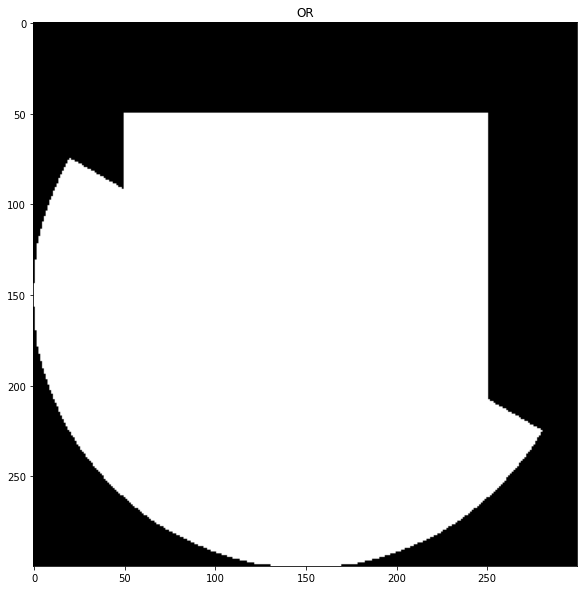

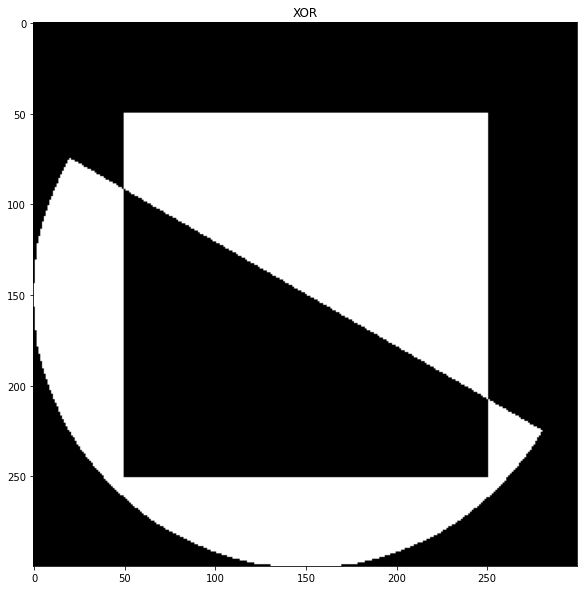

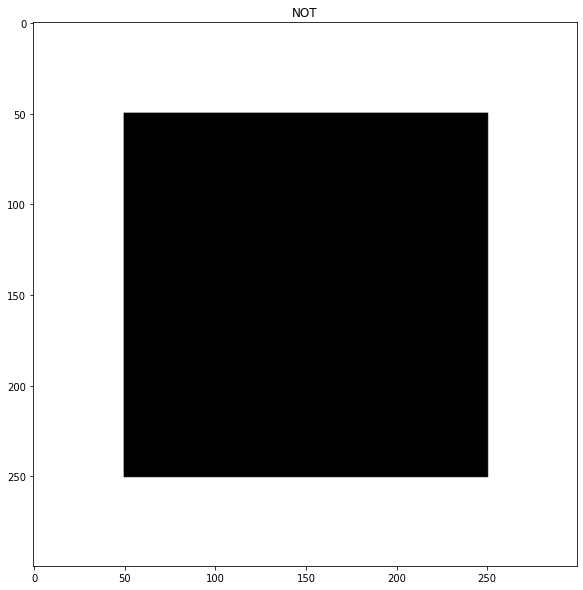

In [42]:
#Shows only when they intersect
AND = cv2.bitwise_and(square, ellipse)
imshow("AND", AND)

# shows either square or ellipse
bitwiseOR = cv2.bitwise_or(square, ellipse)
imshow("OR", bitwiseOR)

#shows where either exist by itself
bitwiseXOR = cv2.bitwise_xor(square, ellipse)
imshow("XOR", bitwiseXOR)

#shows everything that isn't the part of the square
bitwiseNOTsq = cv2.bitwise_not(square)
imshow("NOT", bitwiseNOTsq)




# Convolution

*  Convolution Operation
* Blurring
* Denoising
* Sharpening

#### Blurring using Convolution

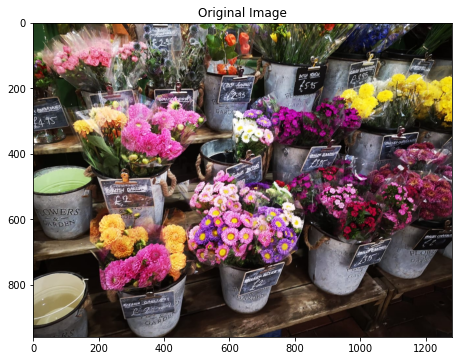

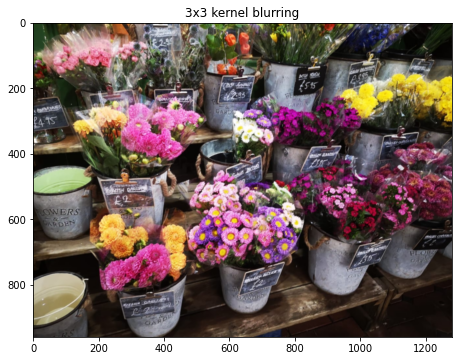

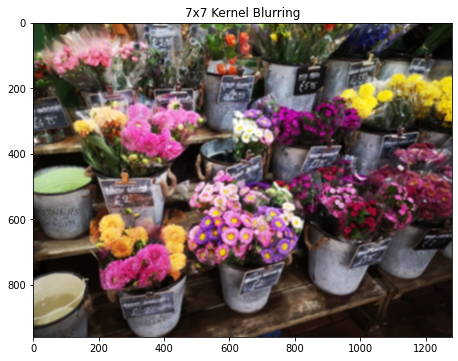

In [43]:
import cv2
import numpy as np

image = cv2.imread('/content/images/flowers.jpeg')
imshow('Original Image', image)

#3x3 kernel
kernel_3x3 = np.ones((3,3), np.float32) / 9

#cv2.filter2D 
blurred = cv2.filter2D(image, -1, kernel_3x3)
imshow("3x3 kernel blurring", blurred)

#7x7 kernel blurred
kernel_7x7 = np.ones((7,7), np.float32)/49

blurred2 = cv2.filter2D(image,-1, kernel_7x7)
imshow('7x7 Kernel Blurring', blurred2)

Blurring Methods
* Regular Blurring
* Gaussian Blurring
* Median Blurring

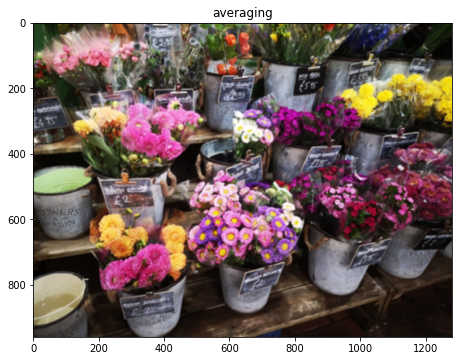

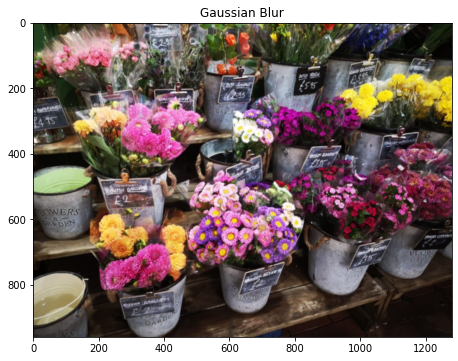

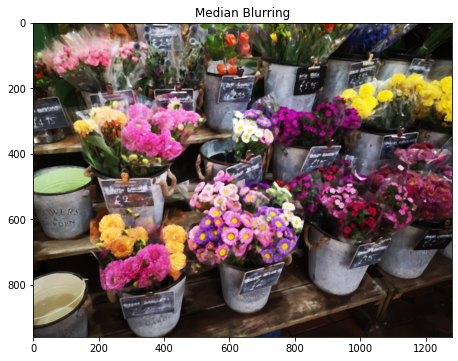

In [44]:
import cv2
import numpy as np

image = cv2.imread('/content/images/flowers.jpeg')

#average pooling
blur = cv2.blur(image, (5,5))
imshow('averaging', blur)

#uses gaussian kernel instead of box filter
Gaussian = cv2.GaussianBlur(image, (5,5), 0)
imshow('Gaussian Blur', Gaussian)

#median of all pizel under kernel area and centrak
#element replaced with median value
median = cv2.medianBlur(image, 5)
imshow("Median Blurring", median)

Bilateral Noise Removal

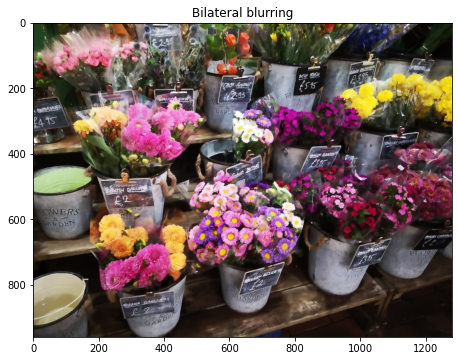

In [45]:
bilateral = cv2.bilateralFilter(image, 9, 75, 75)
imshow('Bilateral blurring', bilateral)

Image Denosing

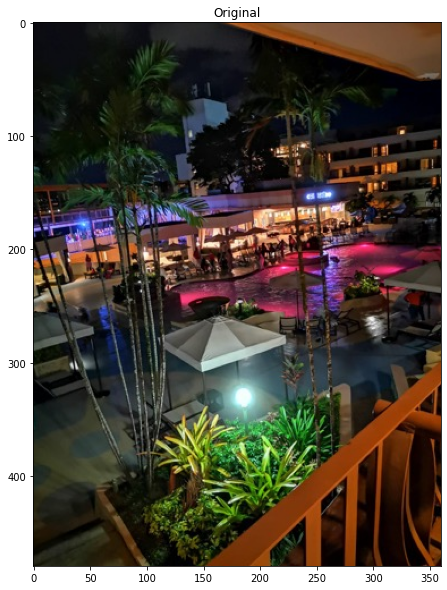

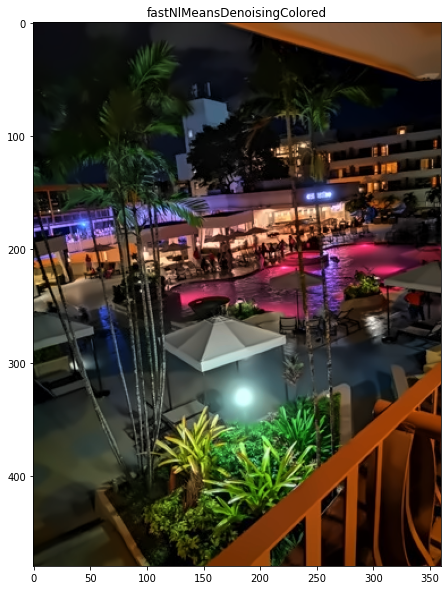

In [46]:
image = cv2.imread('images/hilton.jpeg')
imshow('Original', image)

dst = cv2.fastNlMeansDenoisingColored(image, None, 6,6,7,21)
imshow('fastNlMeansDenoisingColored', dst)

##### Sharpening

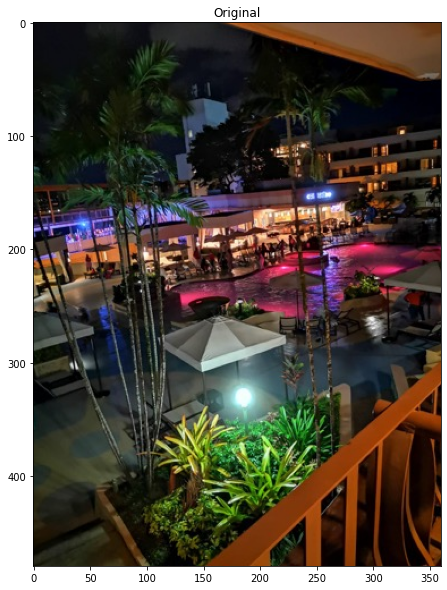

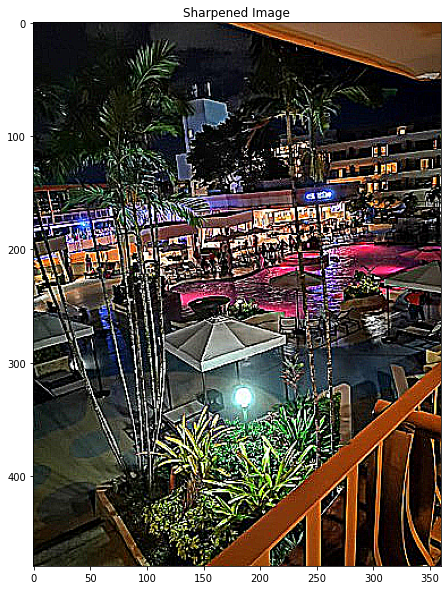

In [47]:
image = cv2.imread('images/hilton.jpeg')
imshow('Original', image)

#Create our sharpening Kernel and sum it to one
kernel_sharpening = np.array([[-1,-1,-1],
                             [-1, 9 ,-1],
                             [-1,-1,-1]])

#applying the sharpening kernel to image
sharpened = cv2.filter2D(image, -1, kernel_sharpening)
imshow('Sharpened Image', sharpened)

# Thresholding, Binarization 

In [48]:
!wget https://raw.githubusercontent.com/rajeevratan84/ModernComputerVision/main/scan.jpeg

--2022-08-26 10:18:51--  https://raw.githubusercontent.com/rajeevratan84/ModernComputerVision/main/scan.jpeg
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 171933 (168K) [image/jpeg]
Saving to: ‘scan.jpeg’

scan.jpeg           100%[===================>] 167.90K  --.-KB/s    in 0.02s   

2022-08-26 10:18:51 (7.01 MB/s) - ‘scan.jpeg’ saved [171933/171933]



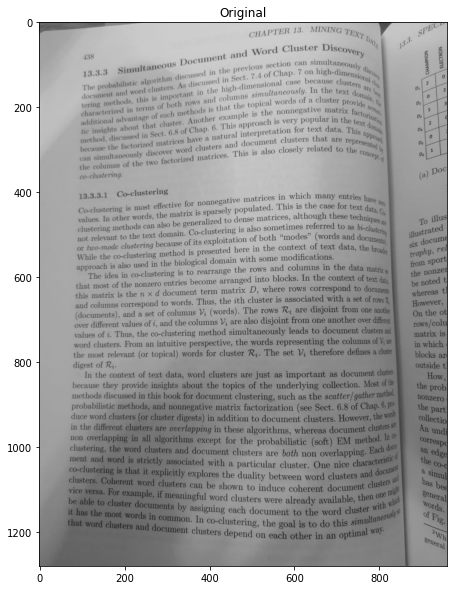

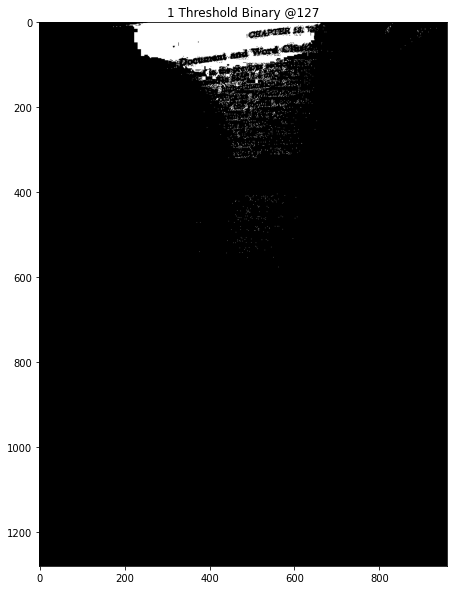

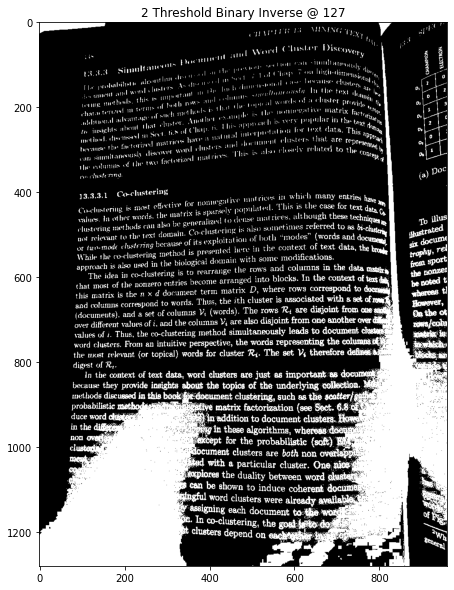

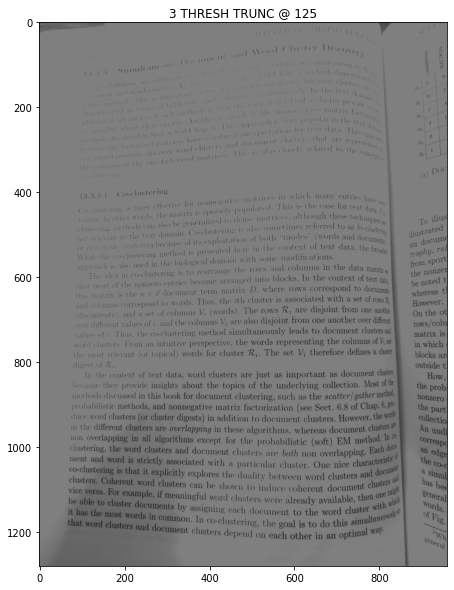

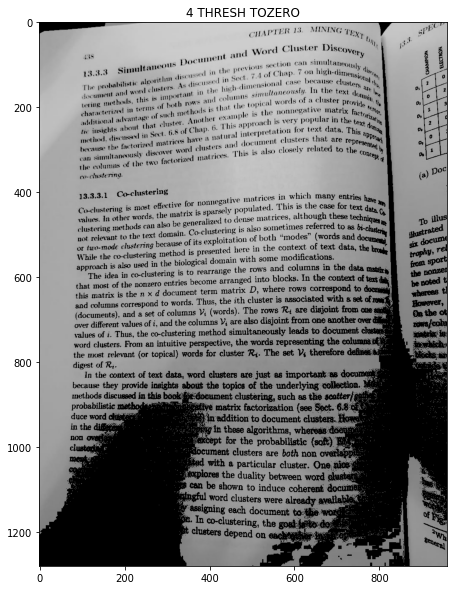

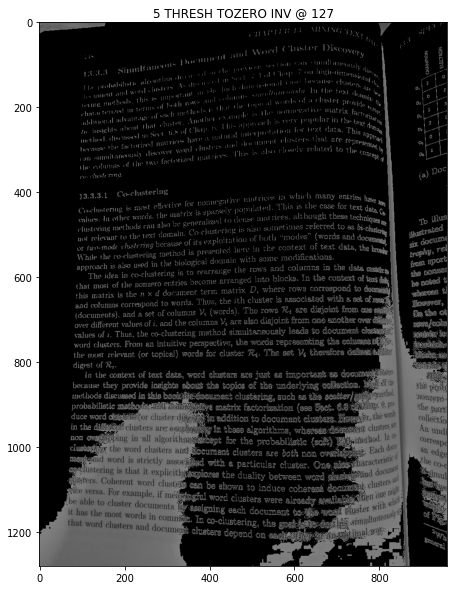

In [49]:
#load image
image = cv2.imread('scan.jpeg', 0)
imshow("Original", image)

#value below 127 goes to 0 or Black, everything above goes to 255(white)
ret, thresh1 = cv2.threshold(image, 200, 255, cv2.THRESH_BINARY)
imshow('1 Threshold Binary @127', thresh1)

#values below 127 go to 255 and values above 127 goes to 0 (reverse of the above)
ret, thresh2 = cv2.threshold(image, 127, 255, cv2.THRESH_BINARY_INV)
imshow('2 Threshold Binary Inverse @ 127', thresh2)

#values above 127 are truncated (held) at 127 (the 255 is unused)
ret, thresh3 = cv2.threshold(image, 127, 255, cv2.THRESH_TRUNC)
imshow('3 THRESH TRUNC @ 125', thresh3)

#values below 127 go to 0, above are unchanged
ret, thresh4 = cv2.threshold(image, 127, 255, cv2.THRESH_TOZERO)
imshow('4 THRESH TOZERO', thresh4)

#reverse of the above, below 127 is unchanged, above 127 goes to 0
ret, thresh5 = cv2.threshold(image, 127, 255, cv2.THRESH_TOZERO_INV)
imshow('5 THRESH TOZERO INV @ 127', thresh5)


# Adaptive Threshold

* ADAPTIVE_THRESH_MEAN_C
* THRESH_OTSU

cv2.adaptiveThreshold(src, maxValue, adaptiveMethod, thresholdType, blockSize, C[, dst] -> dst)

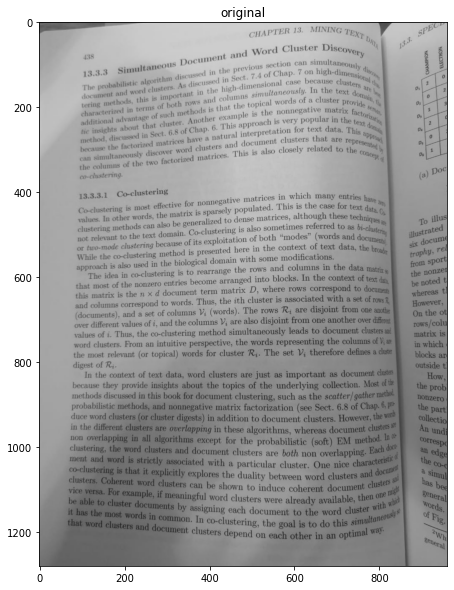

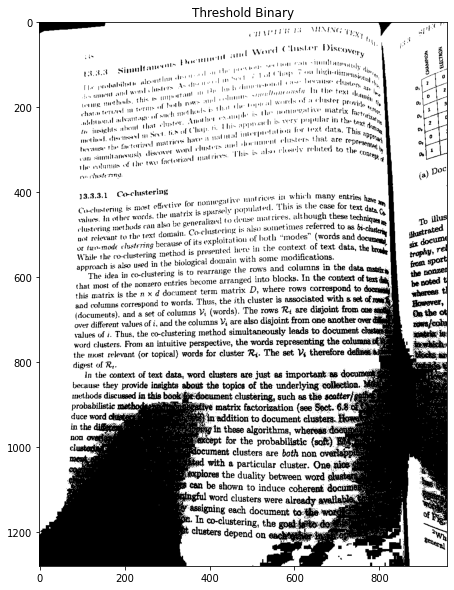

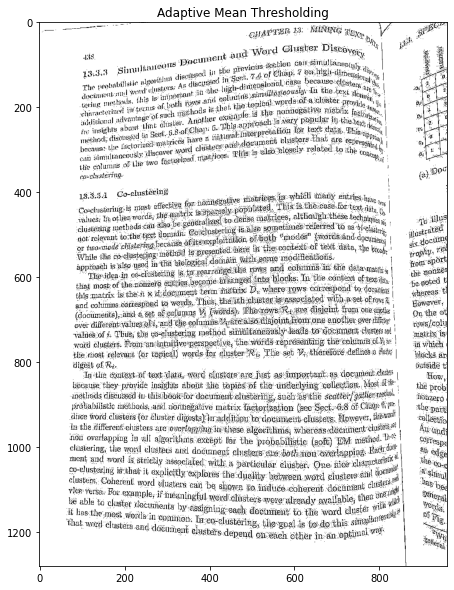

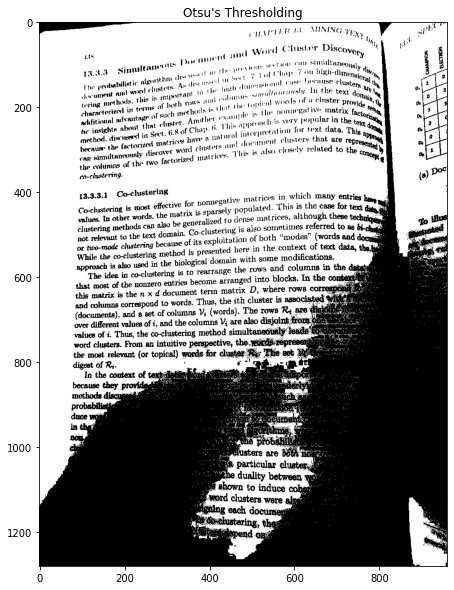

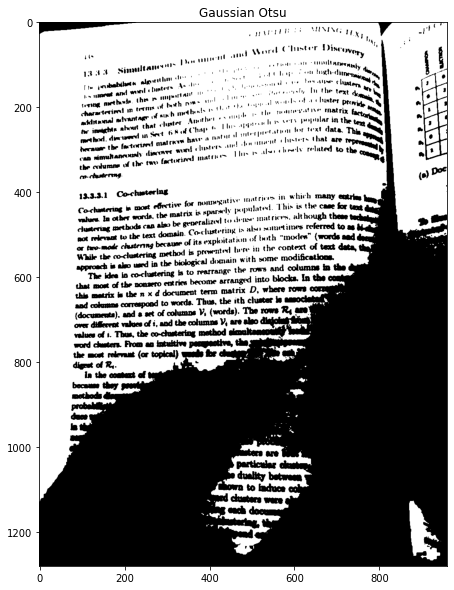

In [50]:
#load image
image = cv2.imread('scan.jpeg', 0)
imshow('original', image)

#values below 127 goes to 0 (black) everything above goes to 255(White)
ret, thresh1 = cv2.threshold(image, 127, 255, cv2.THRESH_BINARY)
imshow('Threshold Binary', thresh1)

# Good practice to blur image as it removes noises
# image = cv2.GaussianBlur(image(3,3),0)

#Using Adaptive Threshold
thresh = cv2.adaptiveThreshold(image, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 3, 5)
imshow('Adaptive Mean Thresholding', thresh)

_, th2 = cv2.threshold(image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
imshow("Otsu's Thresholding", th2)

#Othsu thresholding after gaussian blur
blur = cv2.GaussianBlur(image, (5,5), 0)
_, th3 = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
imshow("Gaussian Otsu", th3)

#### Skimage Threshold Local

threshold_local(image, block_size, offset = 10)

---
threshold_local calculates thresholds in region with characteristic size block_size surrounding each pixel (i.e. local neighbhor). Each Threshold Value is weighted mean of the Local Neighbhorhood minus an offset value


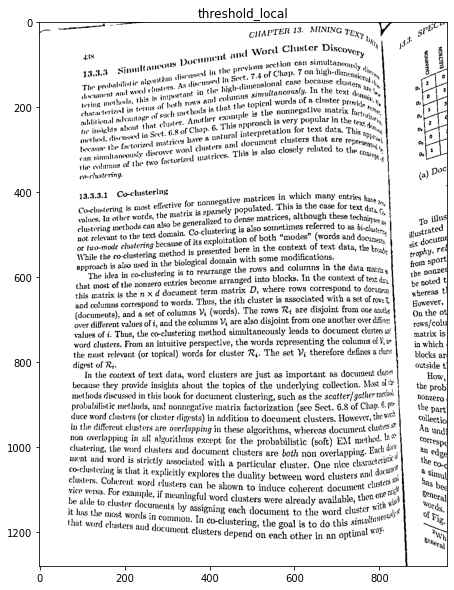

In [51]:
from skimage.filters import threshold_local

image = cv2.imread('scan.jpeg')

#We get value component from HSV Color Space
#then we apply adaptive thresholding

V = cv2.split(cv2.cvtColor(image, cv2.COLOR_BGR2HSV))[2]
T = threshold_local(V, 25, offset = 15, method = "gaussian")

#Apply the threshold
thresh = (V > T).astype("uint8")*255
imshow("threshold_local",thresh)

#### Dilation, Erosion and Edge Detection

* **Dilation**
  Adds pixels to the boundaries of objects in an image
* **Erosion**
  Removes pixels at the boundaries of object in an image
* **Opening**
  Erosion followed by dilation
* **Closing**
  Dilation followed by erosion
* **Canny Edge Detection**

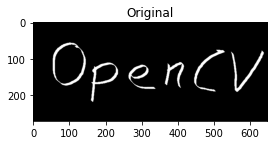

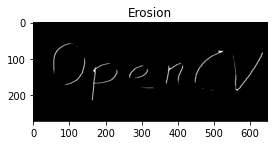

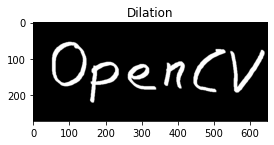

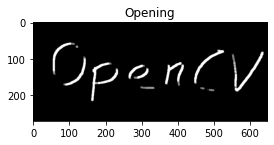

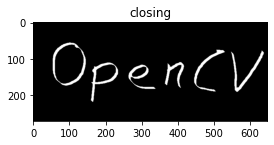

In [56]:
import cv2
import numpy as np

image = cv2.imread('images/opencv_inv.png',0)
imshow('Original', image)

#Lets define our kernel size
kernel = np.ones((5,5), np.uint8)

#Now we erode
erosion = cv2.erode(image, kernel, iterations = 1)
imshow('Erosion', erosion)

#Dilate here
dilation = cv2.dilate(image, kernel, iterations = 1)
imshow('Dilation', dilation)

#Opening - Good for removing noise
opening = cv2.morphologyEx(image, cv2.MORPH_OPEN, kernel)
imshow('Opening', opening)

#Closing - Good for removing noise
closing = cv2.morphologyEx(image, cv2.MORPH_CLOSE, kernel)
imshow('closing', closing)

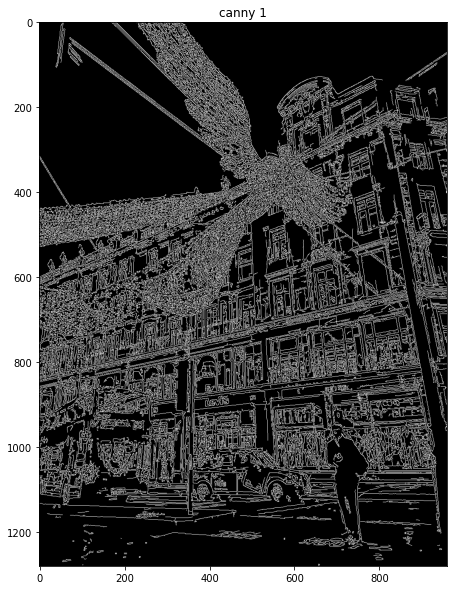

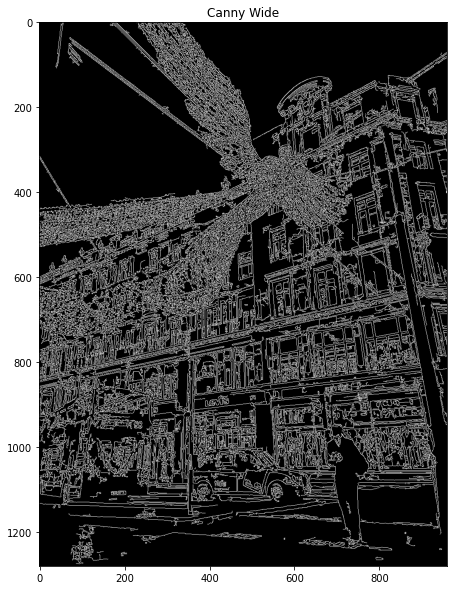

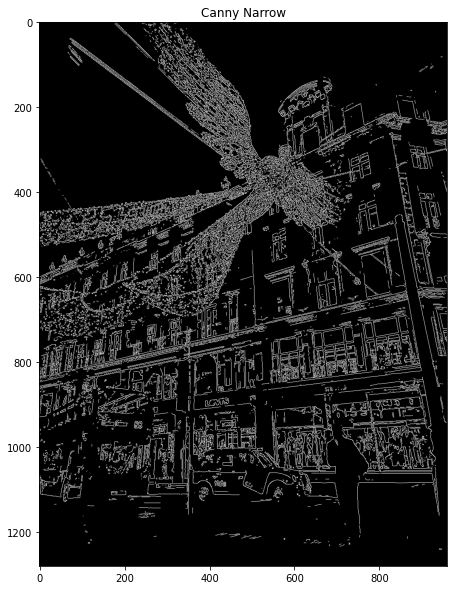

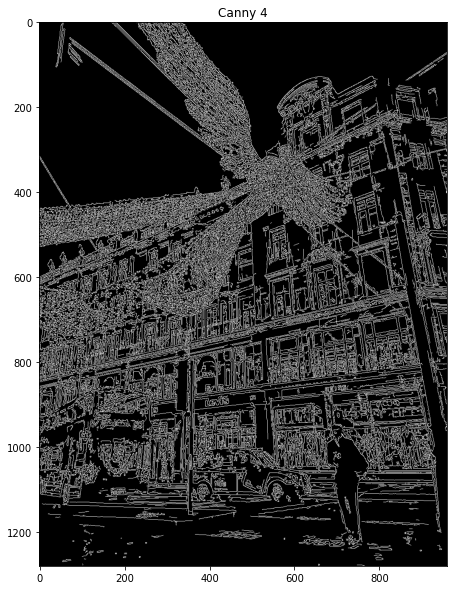

In [57]:
image = cv2.imread('images/londonxmas.jpeg', 0)

#cany edge detection uses gradient values as threshold

#The first threshold as gradient
canny = cv2.Canny(image, 50, 120)
imshow('canny 1', canny)

#wide edge threshold expects lots of edges
canny = cv2.Canny(image, 10, 200)
imshow('Canny Wide', canny)

#Narrow Threshold, Expects less edge
canny = cv2.Canny(image, 200, 240)
imshow('Canny Narrow', canny)

canny = cv2.Canny(image, 60, 110)
imshow('Canny 4', canny)

#### Auto Canny

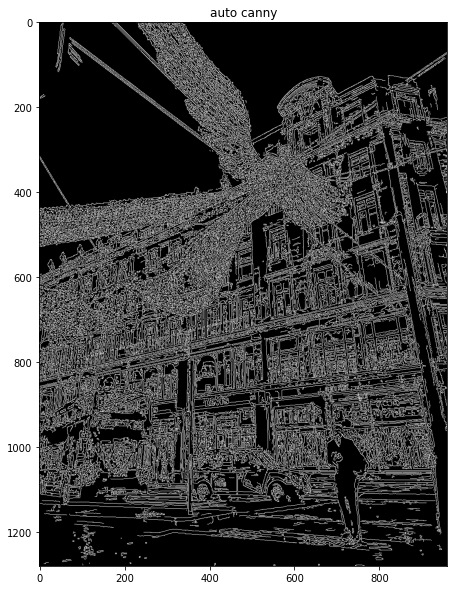

In [60]:
def autoCanny(image):
  #finds optimal threshold based on median image pixel intensity
  blurred_img = cv2.blur(image, ksize = (5,5))
  med_val = np.median(image)
  lower = int(max(0, 0.66 * med_val))
  upper = int(min(255, 1.33*med_val))
  edges = cv2.Canny(image = image, threshold1 = lower, threshold2 = upper)
  return edges

auto_canny = autoCanny(image)
imshow("auto canny", auto_canny)